<a href="https://colab.research.google.com/github/coderzaman/Plant-Disease-Detection/blob/main/plant_disease_detection_with_explainable_ai_xai.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Importing Necessary Libraries & Configuration
In this step, we import all the required libraries for data manipulation, visualization, deep learning model building (Custom CNN & Transfer Learning), and XAI (Explainable AI) implementation. We also set random seeds for reproducibility.

In [ ]:
# --- 1. Core Systems & Utilities ---
import os
import gc               # Garbage collector to save RAM
import time
import random
import math
import warnings
warnings.filterwarnings('ignore')

# --- 2. Data Handling & Numerical Operations ---
import numpy as np
import pandas as pd

# --- 3. Image Processing & Visualization ---
import cv2              # OpenCV
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.cm as cm
import seaborn as sns
import plotly.express as px
from IPython.display import Image, display

# --- 4. Machine Learning Metrics (Scikit-Learn) ---
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.metrics import (
    confusion_matrix,
    classification_report,
    roc_curve,
    auc,
    precision_recall_fscore_support,
    accuracy_score
)

# --- 5. Deep Learning Framework (TensorFlow/Keras) ---
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

# --- 6. Image Preprocessing Tools ---
from tensorflow.keras.preprocessing.image import (
    ImageDataGenerator,
    load_img,
    img_to_array
)

# --- 7. Keras Layers (Functional & Sequential) ---
from tensorflow.keras.layers import (
    Conv2D, BatchNormalization, ReLU, MaxPooling2D,
    Dropout, Flatten, Dense, Input, GlobalAveragePooling2D, Activation
)

# --- 8. Transfer Learning Applications & Specific Preprocessing ---
# 🔥 CRITICAL FIX: Aliasing to avoid NameError and Conflicts 🔥

from tensorflow.keras.applications import ResNet50, MobileNetV2, EfficientNetB0

# ResNet50 Preprocessing (Use 'preprocess_resnet' in your code)
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_resnet

# MobileNetV2 Preprocessing (Use 'preprocess_mobile' in your code)
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_mobile

# EfficientNet Preprocessing (If needed)
from tensorflow.keras.applications.efficientnet import preprocess_input as preprocess_efficientnet

# --- 9. Configuration for Reproducibility ---
np.random.seed(42)
tf.random.set_seed(42)
random.seed(42)

print("All libraries imported successfully!")
print(f"TensorFlow Version: {tf.__version__}")

2026-01-14 10:21:39.955209: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1768386100.157012      24 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1768386100.221252      24 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1768386100.711166      24 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1768386100.711210      24 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1768386100.711213      24 computation_placer.cc:177] computation placer alr

All libraries imported successfully!
TensorFlow Version: 2.19.0


# 2. Data Loading and DataFrame Construction
In this step, we traverse the dataset directory to collect file paths and associated labels (disease classes). We then construct a Pandas DataFrame to structure this data, which facilitates easy manipulation, analysis, and splitting in subsequent steps.

In [ ]:
# Define the dataset directory
base_dir = "/kaggle/input/plantvillage-dataset/color"

# Get the list of all classes (subdirectories)
folds = os.listdir(base_dir)

# Lists to store file paths and labels
filepaths = []
labels = []

# Iterate through each folder (class) to collect image paths
for fold in folds:
    folder_path = os.path.join(base_dir, fold)
    imgs = os.listdir(folder_path)

    # Iterate through each image in the folder
    for img in imgs:
        img_path = os.path.join(folder_path, img)
        filepaths.append(img_path)
        labels.append(fold)

# Create a Pandas DataFrame
df = pd.DataFrame({'filepaths': filepaths, 'labels': labels})

# Display dataset statistics
print(f"Data Loading Complete.")
print(f"Total Images: {len(df)}")
print(f"Total Classes: {len(df['labels'].unique())}")

# Show the first 5 rows of the DataFrame
print("\nSample Data:")
print(df.head())

Data Loading Complete.
Total Images: 54305
Total Classes: 38

Sample Data:
                                           filepaths                labels
0  /kaggle/input/plantvillage-dataset/color/Tomat...  Tomato___Late_blight
1  /kaggle/input/plantvillage-dataset/color/Tomat...  Tomato___Late_blight
2  /kaggle/input/plantvillage-dataset/color/Tomat...  Tomato___Late_blight
3  /kaggle/input/plantvillage-dataset/color/Tomat...  Tomato___Late_blight
4  /kaggle/input/plantvillage-dataset/color/Tomat...  Tomato___Late_blight


# 3. Exploratory Data Analysis (EDA)
In this section, we analyze the dataset to understand the class distribution and visualize sample images. We also examine the RGB color channel distribution to gain insights into the pixel intensity characteristics of the leaf images, which helps in understanding the input data properties.

 #### **DataFrame Construction**

In [ ]:
# --- DataFrame Construction (Using data from Step 2) ---
# Note: In Step 2, we already created 'df'. We can use it directly or rename it.
data = df.copy() # Using the dataframe created in Step 2

print(f"Data Shape: {data.shape}")

Data Shape: (54305, 2)


#### **Visualizing Random Samples**


--- Visualizing Random Sample Images ---


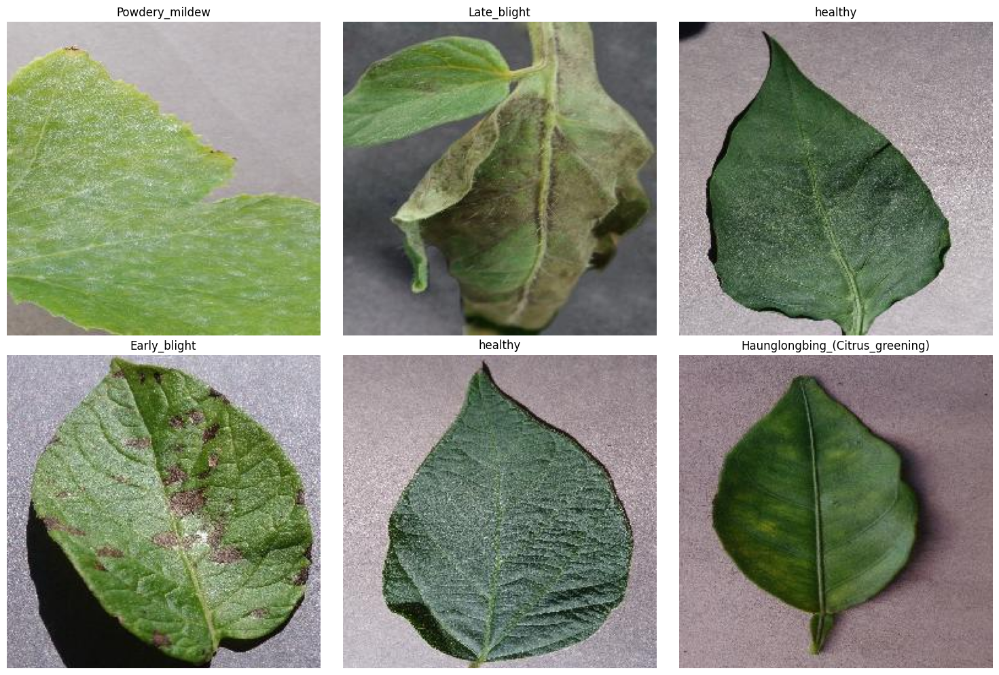

In [ ]:
print("\n--- Visualizing Random Sample Images ---")
plt.figure(figsize=(15, 10))
for i in range(6):
    plt.subplot(2, 3, i+1)
    rand_idx = np.random.randint(0, len(data))
    img_path = data.iloc[rand_idx]['filepaths']
    lbl = data.iloc[rand_idx]['labels']

    # Read and Display Image
    img = plt.imread(img_path)
    plt.imshow(img)
    plt.title(lbl.split('___')[-1], fontsize=12) # Display only the disease name for clarity
    plt.axis('off')

plt.tight_layout()
plt.show()

#### **🌿 Class Distribution in PlantVillage Dataset**

Data Shape: (54305, 2)


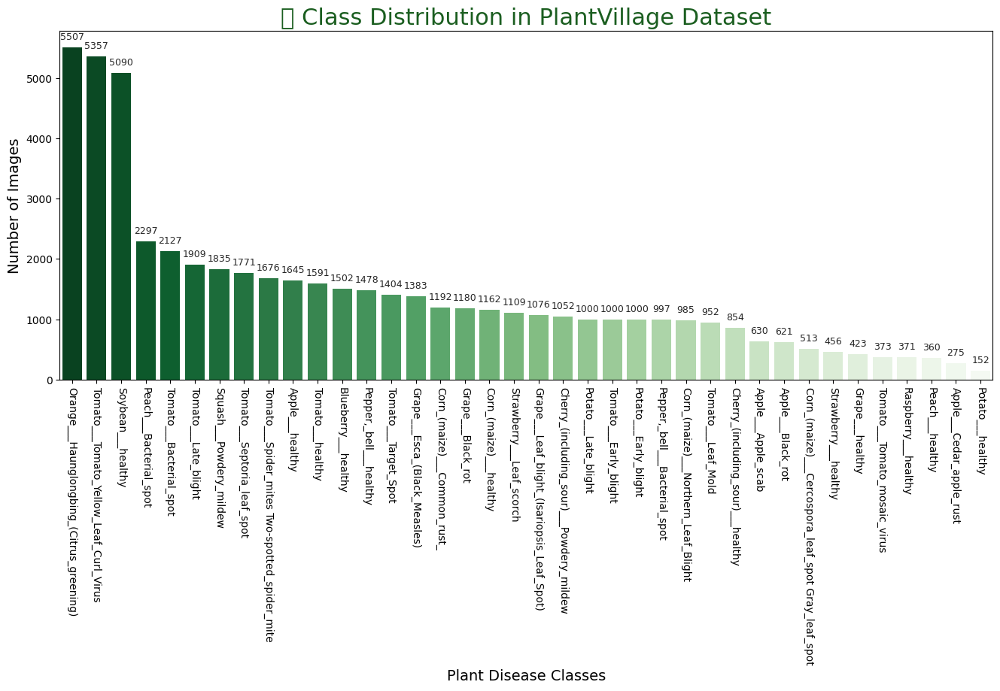

In [ ]:
# --- 3.1 DataFrame Construction (Using data from Step 2) ---
# Note: In Step 2, we already created 'df'. We can use it directly or rename it.
data = df.copy() # Using the dataframe created in Step 2

print(f"Data Shape: {data.shape}")


# Prepare data for plotting
label_counts = data['labels'].value_counts().reset_index()
label_counts.columns = ['Label', 'Count']

# Plotting
plt.figure(figsize=(16, 8))
ax = sns.barplot(
    x='Label',
    y='Count',
    data=label_counts,
    palette='Greens_r'
)

# Styling
ax.set_title('🌿 Class Distribution in PlantVillage Dataset', fontsize=22, color='#1b5e20')
ax.set_xlabel("Plant Disease Classes", fontsize=14)
ax.set_ylabel("Number of Images", fontsize=14)
plt.xticks(rotation=-90) # Rotated 90 degrees for better readability if classes are many
plt.subplots_adjust(bottom=0.3)
sns.set_style('whitegrid')

# Add Count Labels on top of bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10),
                textcoords='offset points', fontsize=9)

plt.show()

In [ ]:
data.labels.value_counts()

labels
Orange___Haunglongbing_(Citrus_greening)              5507
Tomato___Tomato_Yellow_Leaf_Curl_Virus                5357
Soybean___healthy                                     5090
Peach___Bacterial_spot                                2297
Tomato___Bacterial_spot                               2127
Tomato___Late_blight                                  1909
Squash___Powdery_mildew                               1835
Tomato___Septoria_leaf_spot                           1771
Tomato___Spider_mites Two-spotted_spider_mite         1676
Apple___healthy                                       1645
Tomato___healthy                                      1591
Blueberry___healthy                                   1502
Pepper,_bell___healthy                                1478
Tomato___Target_Spot                                  1404
Grape___Esca_(Black_Measles)                          1383
Corn_(maize)___Common_rust_                           1192
Grape___Black_rot                                

#### **RGB Color Channel Distribution**


--- RGB Color Channel Distribution (Sample) ---


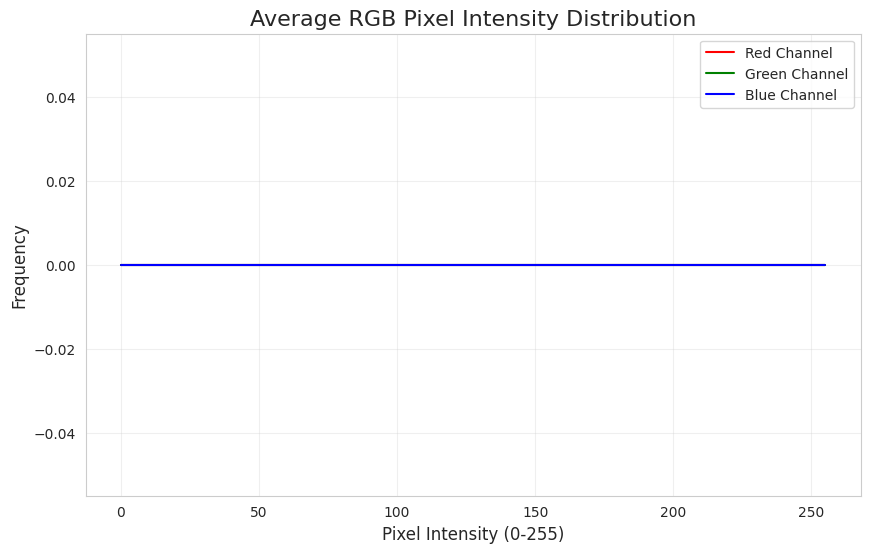

In [ ]:
# --- RGB Color Channel Analysis ---
# This part is highly recommended for a Thesis to show pixel intensity analysis.
print("\n--- RGB Color Channel Distribution (Sample) ---")

def plot_rgb_histogram(df, samples=100):
    """
    Plots the average histogram for Red, Green, and Blue channels
    averaged over a random sample of images.
    """
    sample_indices = np.random.choice(len(df), samples, replace=False)

    # Containers for histograms
    r_hist_avg = np.zeros(256)
    g_hist_avg = np.zeros(256)
    b_hist_avg = np.zeros(256)

    valid_samples = 0

    for idx in sample_indices:
        img_path = df.iloc[idx]['filepaths']
        try:
            img = cv.imread(img_path)
            if img is not None:
                img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

                # Calculate histograms for each channel
                r_hist = cv.calcHist([img], [0], None, [256], [0, 256]).flatten()
                g_hist = cv.calcHist([img], [1], None, [256], [0, 256]).flatten()
                b_hist = cv.calcHist([img], [2], None, [256], [0, 256]).flatten()

                r_hist_avg += r_hist
                g_hist_avg += g_hist
                b_hist_avg += b_hist
                valid_samples += 1
        except Exception as e:
            pass

    # Average the histograms
    if valid_samples > 0:
        r_hist_avg /= valid_samples
        g_hist_avg /= valid_samples
        b_hist_avg /= valid_samples

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.plot(r_hist_avg, color='red', label='Red Channel')
    plt.plot(g_hist_avg, color='green', label='Green Channel')
    plt.plot(b_hist_avg, color='blue', label='Blue Channel')

    plt.title('Average RGB Pixel Intensity Distribution', fontsize=16)
    plt.xlabel('Pixel Intensity (0-255)', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

# Run the RGB Analysis
plot_rgb_histogram(data, samples=200) # Analyze 200 random images

### Observations from EDA:
1.  **Class Imbalance:** The dataset is highly imbalanced, with 'Orange___Haunglongbing' having the highest number of samples (5507) and 'Potato___healthy' having the lowest (152). This disparity necessitates the use of robust data augmentation techniques to prevent model bias.
2.  **Pixel Intensity:** The RGB channel analysis reveals a dominant Green channel intensity, consistent with healthy and diseased plant foliage. A significant spike at intensity 0 (especially in the Blue channel) confirms the presence of segmented black backgrounds in the PlantVillage dataset.

# 4. Splitting Data into Train, Validation, and Test Sets
To ensure a robust evaluation, we split the dataset into three parts:
1. **Training Set (80%):** Used to train the model.
2. **Validation Set (10%):** Used to tune hyperparameters and monitor overfitting during training.
3. **Test Set (10%):** Kept completely unseen to evaluate the final model's performance and for XAI validation.

We employ **stratified sampling** to maintain the same class distribution across all splits, which is critical given the class imbalance observed in the EDA.

#### **Data Splitting: Train, Validation, and Test Sets**

In [ ]:
# --- Splitting Strategy ---
# First, split into Training (80%) and Temporary (20%) sets
# 'stratify' ensures that the proportion of each class matches the original dataset
train_data, temp_data = train_test_split(
    data,
    test_size=0.2,
    shuffle=True,
    stratify=data['labels'],
    random_state=42
)

# Next, split the Temporary set equally into Validation (10%) and Test (10%) sets
valid_data, test_data = train_test_split(
    temp_data,
    test_size=0.5,
    shuffle=True,
    stratify=temp_data['labels'],
    random_state=42
)

#### **Verification**

In [ ]:
# --- Verification ---
print("--- Data Split Statistics ---")
print(f"Training Set:   {train_data.shape[0]} images (80%)")
print(f"Validation Set: {valid_data.shape[0]} images (10%)")
print(f"Test Set:       {test_data.shape[0]} images (10%)")

--- Data Split Statistics ---
Training Set:   43444 images (80%)
Validation Set: 5430 images (10%)
Test Set:       5431 images (10%)


#### **Integrity Check**

In [ ]:
# --- Integrity Check ---
# Ensure all classes are present in all sets (Crucial for rare classes)
train_classes = len(train_data.labels.value_counts())
valid_classes = len(valid_data.labels.value_counts())
test_classes = len(test_data.labels.value_counts())
total_classes = len(data.labels.unique())

print(f"\n--- Class Integrity Check ---")
print(f"Total Unique Classes: {total_classes}")
print(f"Classes in Train:     {train_classes}")
print(f"Classes in Valid:     {valid_classes}")
print(f"Classes in Test:      {test_classes}")

# Assert that all sets have all classes (This will throw an error if something is wrong)
assert train_classes == total_classes, "Error: Missing classes in Training Set"
assert valid_classes == total_classes, "Error: Missing classes in Validation Set"
assert test_classes == total_classes, "Error: Missing classes in Test Set"

print("\nSuccess: Stratified split completed successfully. All classes represented in all sets.")


--- Class Integrity Check ---
Total Unique Classes: 38
Classes in Train:     38
Classes in Valid:     38
Classes in Test:      38

Success: Stratified split completed successfully. All classes represented in all sets.


# 5. Data Preprocessing and Augmentation
In this step, we initialize `ImageDataGenerator` for dynamic data loading.

- **Training Data:** We apply **Data Augmentation** techniques (rotation, zooming, horizontal flipping, shifting) to artificially increase the diversity of the training set. This helps prevent overfitting, especially for classes with fewer samples.
- **Validation & Test Data:** These are only rescaled (normalized to 0-1 range) without any distortion to ensure accurate evaluation on real-world images.

#### **Configuration Hyperparameters**

In [ ]:
BATCH_SIZE = 32
IMG_SIZE = (224, 224)  # Standard input size for most Deep Learning models
CHANNELS = 3

In [ ]:
# --- 1. Training Generator (With Augmentation) ---
train_datagen = ImageDataGenerator(
    rescale=1./255,             # Normalize pixel values [0, 255] -> [0, 1]
    rotation_range=20,          # Random rotation between -20 to +20 degrees
    width_shift_range=0.2,      # Horizontal shift
    height_shift_range=0.2,     # Vertical shift
    zoom_range=0.2,             # Random zoom
    horizontal_flip=True,       # Horizontal flipping
    fill_mode='nearest'         # Handling newly created pixels
)


In [ ]:
# --- 2. Validation & Test Generator (Rescale Only) ---
# No augmentation for validation/test to maintain data integrity
test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
# --- 3. Flow from DataFrame ---
print("--- Loading Training Data ---")
train_gen = train_datagen.flow_from_dataframe(
    dataframe=train_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=True,              # Important for training
    seed=42
)

print("\n--- Loading Validation Data ---")
valid_gen = test_datagen.flow_from_dataframe(
    dataframe=valid_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False,             # Usually False for validation to keep order stable
    seed=42
)

print("\n--- Loading Test Data ---")
test_gen = test_datagen.flow_from_dataframe(
    dataframe=test_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False              # CRITICAL: Must be False for correct confusion matrix later
)

--- Loading Training Data ---
Found 43444 validated image filenames belonging to 38 classes.

--- Loading Validation Data ---
Found 5430 validated image filenames belonging to 38 classes.

--- Loading Test Data ---
Found 5431 validated image filenames belonging to 38 classes.


In [ ]:
# --- Verify Generator Output ---
# Check the shape of one batch
images, labels = next(train_gen)
print(f"\nBatch Shape Check: {images.shape}")  # Should be (32, 224, 224, 3)
print(f"Label Shape Check: {labels.shape}")  # Should be (32, 38)


Batch Shape Check: (32, 224, 224, 3)
Label Shape Check: (32, 38)


## 5.1 Class Mapping Verification
Here we verify the mapping between the class names (strings) and the integer labels (indices) assigned by the generator. This mapping is essential for interpreting the model's predictions and plotting the confusion matrix later.

In [ ]:
# 5.1 Check Class Label Mappings

# Get the dictionary of class indices
class_indices = train_gen.class_indices
print("--- Class Names and Assigned Indices ---")

# Print them nicely
for class_name, class_index in class_indices.items():
    print(f"Index {class_index}: {class_name}")

print("\n--- Iteration completed. Mapping is correct. ---")

# Save the class names as a list for later use (e.g., in Classification Report)
class_names = list(class_indices.keys())
print(f"\nStored {len(class_names)} class names for future reference.")

--- Class Names and Assigned Indices ---
Index 0: Apple___Apple_scab
Index 1: Apple___Black_rot
Index 2: Apple___Cedar_apple_rust
Index 3: Apple___healthy
Index 4: Blueberry___healthy
Index 5: Cherry_(including_sour)___Powdery_mildew
Index 6: Cherry_(including_sour)___healthy
Index 7: Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
Index 8: Corn_(maize)___Common_rust_
Index 9: Corn_(maize)___Northern_Leaf_Blight
Index 10: Corn_(maize)___healthy
Index 11: Grape___Black_rot
Index 12: Grape___Esca_(Black_Measles)
Index 13: Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
Index 14: Grape___healthy
Index 15: Orange___Haunglongbing_(Citrus_greening)
Index 16: Peach___Bacterial_spot
Index 17: Peach___healthy
Index 18: Pepper,_bell___Bacterial_spot
Index 19: Pepper,_bell___healthy
Index 20: Potato___Early_blight
Index 21: Potato___Late_blight
Index 22: Potato___healthy
Index 23: Raspberry___healthy
Index 24: Soybean___healthy
Index 25: Squash___Powdery_mildew
Index 26: Strawberry___Leaf_scorch
In

# 6. Proposed Custom CNN Architecture
In this phase, we design and train a custom Convolutional Neural Network (CNN) tailored for plant disease detection. Unlike standard CNNs, this architecture incorporates several modern deep learning optimizations to ensure high accuracy while maintaining computational efficiency:

1.  **Swish Activation:** We replace the traditional ReLU activation with **Swish** ($f(x) = x \cdot \text{sigmoid}(x)$). Swish allows for better gradient flow during backpropagation, helping the model learn complex patterns more effectively.
2.  **Global Average Pooling (GAP):** Instead of using a traditional `Flatten` layer which generates millions of parameters, we use `GlobalAveragePooling2D`. This drastically reduces the model size and minimizes the risk of overfitting.
3.  **Label Smoothing:** We utilize **Label Smoothing (0.1)** in the loss function. This prevents the model from becoming overconfident in its predictions, thereby improving its ability to generalize to unseen data (Test Set).

#### **Custom CNN Model Implementation**

In [ ]:
# 6. Custom CNN Model Implementation

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (
    Conv2D, BatchNormalization, MaxPooling2D, Dropout,
    Dense, GlobalAveragePooling2D, Activation, InputLayer
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
import os

In [ ]:
# --- Configuration ---
NUM_CLASSES = len(train_gen.class_indices)
IMG_SHAPE = (IMG_SIZE[0], IMG_SIZE[1], 3)
EPOCHS = 25

In [ ]:
# --- Model Architecture ---
model = Sequential([
    InputLayer(input_shape=IMG_SHAPE),

    # --- Block 1: Feature Extraction (Low Level) ---
    Conv2D(32, (3, 3), padding='same'),
    BatchNormalization(),
    Activation('swish'),  # Swish is often superior to ReLU in deep networks
    Conv2D(64, (3, 3), padding='same'),
    BatchNormalization(),
    Activation('swish'),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    # --- Block 2: Feature Extraction (Mid Level) ---
    Conv2D(64, (3, 3), padding='same'),
    BatchNormalization(),
    Activation('swish'),
    Conv2D(128, (3, 3), padding='same'),
    BatchNormalization(),
    Activation('swish'),
    MaxPooling2D((2, 2)),
    Dropout(0.25),

    # --- Block 3: Feature Extraction (High Level) ---
    Conv2D(128, (3, 3), padding='same'),
    BatchNormalization(),
    Activation('swish'),
    Conv2D(256, (3, 3), padding='same'),
    BatchNormalization(),
    Activation('swish'),
    MaxPooling2D((2, 2)),
    Dropout(0.3),

    # --- Classification Head (Optimized) ---
    # GlobalAveragePooling2D reduces parameters significantly compared to Flatten()
    GlobalAveragePooling2D(),

    Dense(256),
    BatchNormalization(),
    Activation('swish'),
    Dropout(0.5),

    # Output Layer
    Dense(NUM_CLASSES, activation='softmax')
])

# Display Model Structure
model.summary()

I0000 00:00:1768386247.196843      24 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 224, 224, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 224, 224, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 224, 224, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 224, 224, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 112, 112, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 112, 112, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 112, 112, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 56, 56, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 56, 56, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 56, 56, 256)    │             

 Total params: 652,198 (2.49 MB)

 Trainable params: 650,342 (2.48 MB)

 Non-trainable params: 1,856 (7.25 KB)

In [ ]:
# --- Compilation ---
print("\n--- Compiling the model with Label Smoothing ---")
model.compile(
    optimizer=Adam(learning_rate=0.001),
    # Label smoothing helps the model generalize better by penalizing overconfidence
    loss=CategoricalCrossentropy(label_smoothing=0.1),
    metrics=['accuracy']
)


--- Compiling the model with Label Smoothing ---


In [ ]:
# --- Callbacks Setup ---
checkpoint_dir = "/kaggle/working/model_checkpoints/"
os.makedirs(checkpoint_dir, exist_ok=True)
checkpoint_filepath = os.path.join(checkpoint_dir, "best_custom_cnn.keras")

callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=3,
        min_lr=0.00001,
        verbose=1
    ),
    ModelCheckpoint(
        filepath=checkpoint_filepath,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    )
]


In [ ]:
# --- Training ---
print("\n--- Starting Training Process ---")
history = model.fit(
    train_gen,
    epochs=EPOCHS,
    validation_data=valid_gen,
    callbacks=callbacks,
    verbose=1
)


--- Starting Training Process ---
Epoch 1/25


I0000 00:00:1768386255.503655      68 service.cc:152] XLA service 0x7816300098c0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1768386255.503701      68 service.cc:160]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1768386256.535670      68 cuda_dnn.cc:529] Loaded cuDNN version 91002
2026-01-14 10:24:24.582544: E external/local_xla/xla/service/slow_operation_alarm.cc:73] Trying algorithm eng0{} for conv %cudnn-conv-bw-filter.7 = (f32[64,32,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,32,224,224]{3,2,1,0} %bitcast.18504, f32[32,64,224,224]{3,2,1,0} %bitcast.18568), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", metadata={op_type="Conv2DBackpropFilter" op_name="gradient_tape/sequential_1/conv2d_1_2/convolution/Conv2DBackpropFilter" source_file="/usr/local/lib/python3.12/dist-packages/tensorflow/python/framework/ops.py" source_line=1200}

1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 569ms/step - accuracy: 0.5340 - loss: 2.1045
Epoch 1: val_loss improved from inf to 1.63583, saving model to /kaggle/working/model_checkpoints/best_custom_cnn.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 840s 603ms/step - accuracy: 0.5341 - loss: 2.1043 - val_accuracy: 0.6773 - val_loss: 1.6358 - learning_rate: 0.0010
Epoch 2/25
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step - accuracy: 0.7999 - loss: 1.3355
Epoch 2: val_loss improved from 1.63583 to 1.36624, saving model to /kaggle/working/model_checkpoints/best_custom_cnn.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 530s 390ms/step - accuracy: 0.7999 - loss: 1.3355 - val_accuracy: 0.7840 - val_loss: 1.3662 - learning_rate: 0.0010
Epoch 3/25
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step - accuracy: 0.8745 - loss: 1.1570
Epoch 3: val_loss did not improve from 1.36624
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 519s 382ms/step - accuracy: 0.8745 - loss: 1.1570 - val_accuracy: 0.7343 - val_loss: 1.4821 - learning_rate: 0.0010
Epoch 4/2

#### **Step 6.1: Visualizing Training Results (Graphs)**

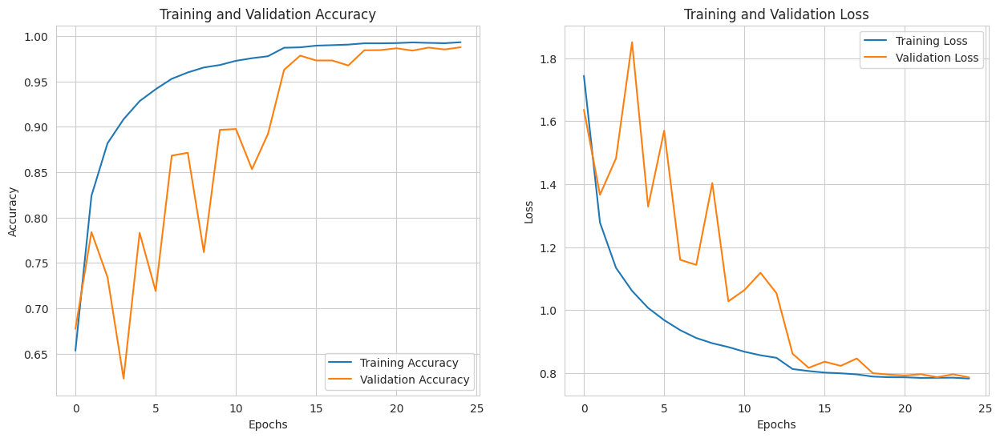

In [ ]:
# 6.1 Visualize Training History

def plot_training_history(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs_range = range(len(acc))

    plt.figure(figsize=(15, 6))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')

    plt.show()

# Plot the graphs
plot_training_history(history)

#### **6.2 Model Evaluation on Test Set**
After training, we evaluate the best-saved model on the unseen Test Set (10% of data). This step provides the unbiased performance metrics required for the thesis conclusion. We also generate a **Confusion Matrix** to visualize misclassifications and a **Classification Report** for class-wise Precision, Recall, and F1-Scores.

--- Evaluating on Test Set ---
170/170 ━━━━━━━━━━━━━━━━━━━━ 28s 158ms/step - accuracy: 0.9868 - loss: 0.7974

Test Accuracy: 98.93%
Test Loss: 0.7904
170/170 ━━━━━━━━━━━━━━━━━━━━ 12s 64ms/step


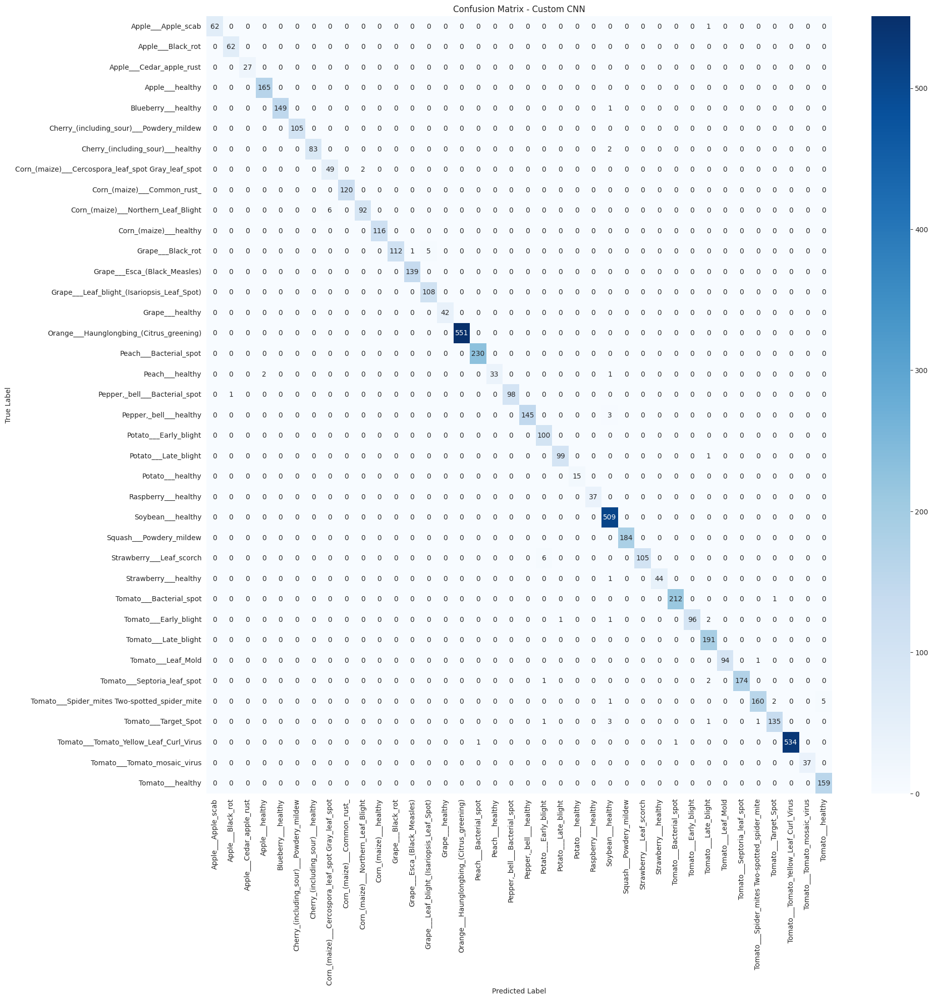


--- Classification Report ---
                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      0.98      0.99        63
                                 Apple___Black_rot       0.98      1.00      0.99        62
                          Apple___Cedar_apple_rust       1.00      1.00      1.00        27
                                   Apple___healthy       0.99      1.00      0.99       165
                               Blueberry___healthy       1.00      0.99      1.00       150
          Cherry_(including_sour)___Powdery_mildew       1.00      1.00      1.00       105
                 Cherry_(including_sour)___healthy       1.00      0.98      0.99        85
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.89      0.96      0.92        51
                       Corn_(maize)___Common_rust_       1.00      1.00      1.00       120
               Corn_(maize)___Northern_Leaf_Blig

In [ ]:
# 6.2 Evaluate on Test Data

# 1. Load the best saved model (Crucial step!)
# We must load the checkpoint because the final epoch model might not be the best one.
best_model = tf.keras.models.load_model("/kaggle/working/model_checkpoints/best_custom_cnn.keras")

print("--- Evaluating on Test Set ---")
test_loss, test_acc = best_model.evaluate(test_gen)
print(f"\nTest Accuracy: {test_acc * 100:.2f}%")
print(f"Test Loss: {test_loss:.4f}")

# 2. Generate Predictions
# We reset the generator to ensure we start from the first image
test_gen.reset()
predictions = best_model.predict(test_gen, verbose=1)

# Convert probabilities to class indices (e.g., [0.1, 0.9] -> 1)
predicted_indices = np.argmax(predictions, axis=1)

# Get true labels from the generator
true_indices = test_gen.classes
class_labels = list(test_gen.class_indices.keys())

# 3. Confusion Matrix
cm = confusion_matrix(true_indices, predicted_indices)

plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix - Custom CNN')
plt.show()

# 4. Classification Report
print("\n--- Classification Report ---")
report = classification_report(true_indices, predicted_indices, target_names=class_labels)
print(report)

--- Loading Custom CNN Model ---


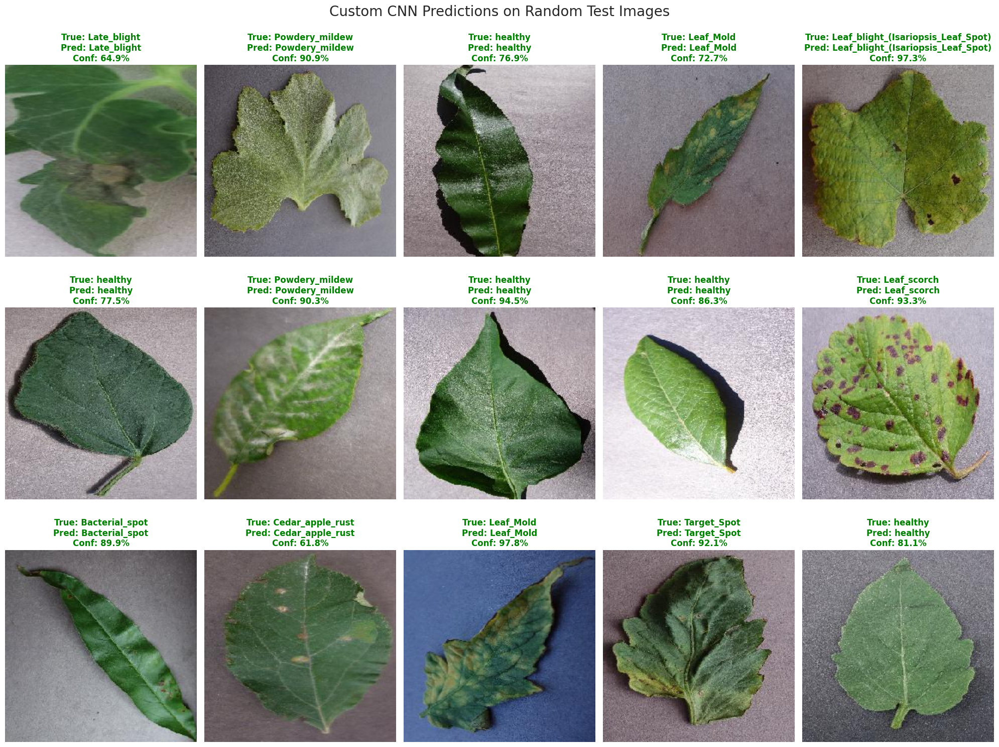

In [ ]:
# 9. Visualizing Random Sample Predictions using Custom CNN

import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

# 1. Load the Best Custom CNN Model
print("--- Loading Custom CNN Model ---")
model_pred = tf.keras.models.load_model("/kaggle/working/model_checkpoints/best_custom_cnn.keras")

# 2. Get Class Labels (Index -> Name)
# train_gen.class_indices gives {'Apple___Black_rot': 0, ...}
# We need {0: 'Apple___Black_rot', ...} to decode predictions
class_map = {v: k for k, v in train_gen.class_indices.items()}

# 3. Select Random Images from Test Data
# We will pick 15 random images to display
num_samples = 15
random_indices = np.random.choice(len(test_data), num_samples, replace=False)

plt.figure(figsize=(20, 15))

for i, idx in enumerate(random_indices):
    # Get image path and true label from dataframe
    row = test_data.iloc[idx]
    img_path = row['filepaths']
    true_label = row['labels']

    # --- Preprocessing (Crucial for Custom CNN) ---
    # Load Image
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=IMG_SIZE)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # Expand dims (1, 224, 224, 3)
    img_batch = np.expand_dims(img_array, axis=0)

    # Normalize: Custom CNN was trained with 1./255, so we MUST divide by 255.0
    img_batch = img_batch / 255.0

    # --- Prediction ---
    prediction = model_pred.predict(img_batch, verbose=0)
    pred_idx = np.argmax(prediction)  # Get index of highest probability
    pred_label = class_map[pred_idx]  # Convert index to name
    confidence = np.max(prediction) * 100 # Get confidence percentage

    # --- Plotting ---
    plt.subplot(3, 5, i + 1)
    plt.imshow(img_array.astype('uint8')) # Show original image

    # Color logic: Green if correct, Red if wrong
    color = 'green' if true_label == pred_label else 'red'

    # Clean up the label name (remove '___' for better display)
    title_true = true_label.split('___')[-1]
    title_pred = pred_label.split('___')[-1]

    plt.title(f"True: {title_true}\nPred: {title_pred}\nConf: {confidence:.1f}%",
              color=color, fontsize=12, fontweight='bold')
    plt.axis('off')

plt.tight_layout()
plt.suptitle("Custom CNN Predictions on Random Test Images", fontsize=20, y=1.02)
plt.show()

# 7. Transfer Learning using ResNet50
To benchmark our proposed Custom CNN, we implement **ResNet50**, a standard deep learning architecture pre-trained on the ImageNet dataset. We utilize a **Feature Extraction** strategy:
1.  **Base Model:** We load the ResNet50 model without its top classification layer (`include_top=False`) and freeze its weights (`trainable=False`). This allows us to reuse the robust feature extractors learned from millions of images.
2.  **Custom Head:** We attach a lightweight classification head (GlobalAveragePooling + Dense Layers) similar to our custom model to adapt the pre-trained features for plant disease classification.

#### **Step 7.1: Reload Data Generators (Crucial for ResNet)**

In [ ]:
# 7.1 Preprocessing Setup for ResNet50
# ResNet50 requires specific input preprocessing (not just 1/255 scaling).
# We must reload the generators using the 'preprocess_input' function.

from tensorflow.keras.applications.resnet50 import preprocess_input

BATCH_SIZE = 32
IMG_SIZE = (224, 224)

# --- 1. Training Generator (ResNet Specific) ---
train_datagen_resnet = ImageDataGenerator(
    preprocessing_function=preprocess_input, # <--- KEY CHANGE
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# --- 2. Validation Generator (ResNet Specific) ---
test_datagen_resnet = ImageDataGenerator(
    preprocessing_function=preprocess_input  # <--- KEY CHANGE
)

# --- 3. Reload Data ---
print("--- Reloading Data for ResNet50 ---")

train_gen_resnet = train_datagen_resnet.flow_from_dataframe(
    dataframe=train_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42
)

valid_gen_resnet = test_datagen_resnet.flow_from_dataframe(
    dataframe=valid_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False,
    seed=42
)

--- Reloading Data for ResNet50 ---
Found 43444 validated image filenames belonging to 38 classes.
Found 5430 validated image filenames belonging to 38 classes.


#### **Step 7.2: ResNet50 Model Implementation**

In [ ]:
# --- Imports ---
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, BatchNormalization, Activation

# --- Configuration ---
IMG_SHAPE = (224, 224, 3)
NUM_CLASSES = len(train_gen.class_indices)
EPOCHS_TL = 20  # Transfer learning converges faster, so 20 epochs is usually enough

# --- Model Architecture ---

# 1. Load Base Model (Pre-trained on ImageNet)
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=IMG_SHAPE)

# 2. Freeze Base Model (Feature Extraction Mode)
base_model.trainable = False

# 3. Add Custom Classification Head
x = base_model.output
x = GlobalAveragePooling2D()(x) # Reduces dimensions

# Dense Block (Similar to Custom CNN Head for fair comparison)
x = Dense(256)(x)
x = BatchNormalization()(x)
x = Activation('swish')(x)      # Consistency: Using Swish as used in Custom CNN
x = Dropout(0.5)(x)

# Output Layer
predictions = Dense(NUM_CLASSES, activation='softmax')(x)

# 4. Final Model Assembly
resnet_model = Model(inputs=base_model.input, outputs=predictions)

# Display Model Structure (Showing only the summary of the new model)
resnet_model.summary()
print(f"ResNet50 Initialized. Total Layers: {len(resnet_model.layers)}")

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "functional_61"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer_1[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 24,123,046 (92.02 MB)

 Trainable params: 534,822 (2.04 MB)

 Non-trainable params: 23,588,224 (89.98 MB)

ResNet50 Initialized. Total Layers: 181


In [ ]:
# --- Compilation ---
print("\n--- Compiling ResNet50 with Label Smoothing ---")
resnet_model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss=CategoricalCrossentropy(label_smoothing=0.1),
    metrics=['accuracy']
)


--- Compiling ResNet50 with Label Smoothing ---


In [ ]:
# --- Callbacks Setup ---
# Note: We changed the filename to 'best_resnet50.keras' to avoid overwriting the Custom CNN
checkpoint_dir = "/kaggle/working/model_checkpoints/"
os.makedirs(checkpoint_dir, exist_ok=True)
checkpoint_filepath_resnet = os.path.join(checkpoint_dir, "best_resnet50.keras")

callbacks_resnet = [
    EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=3,
        min_lr=0.00001,
        verbose=1
    ),
    ModelCheckpoint(
        filepath=checkpoint_filepath_resnet,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    )
]

In [ ]:
# --- Training ---
print("\n--- Starting ResNet50 Training Process ---")
history_resnet = resnet_model.fit(
    train_gen_resnet,            # Using the NEW generator
    epochs=EPOCHS_TL,
    validation_data=valid_gen_resnet, # Using the NEW generator
    callbacks=callbacks_resnet,
    verbose=1
)


--- Starting ResNet50 Training Process ---
Epoch 1/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step - accuracy: 0.8152 - loss: 1.3487
Epoch 1: val_loss improved from inf to 0.91027, saving model to /kaggle/working/model_checkpoints/best_resnet50.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 506s 364ms/step - accuracy: 0.8152 - loss: 1.3486 - val_accuracy: 0.9567 - val_loss: 0.9103 - learning_rate: 0.0010
Epoch 2/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step - accuracy: 0.9480 - loss: 0.9560
Epoch 2: val_loss improved from 0.91027 to 0.87843, saving model to /kaggle/working/model_checkpoints/best_resnet50.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 478s 352ms/step - accuracy: 0.9480 - loss: 0.9560 - val_accuracy: 0.9621 - val_loss: 0.8784 - learning_rate: 0.0010
Epoch 3/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step - accuracy: 0.9599 - loss: 0.9162
Epoch 3: val_loss improved from 0.87843 to 0.84562, saving model to /kaggle/working/model_checkpoints/best_resnet50.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━

#### **Step 7.3: Visualizing Training History (Graphs)**

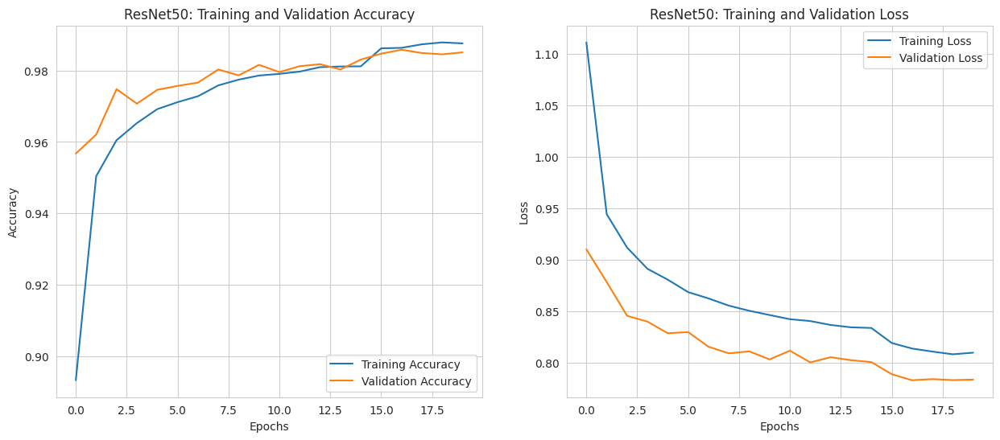

In [ ]:
# 7.3 Visualize ResNet50 Training History

import matplotlib.pyplot as plt

def plot_training_history_resnet(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs_range = range(len(acc))

    plt.figure(figsize=(15, 6))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('ResNet50: Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('ResNet50: Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')

    plt.show()

# Plot the graphs for ResNet
plot_training_history_resnet(history_resnet)

#### **Step 7.4: Model Evaluation on Test Set**
We evaluate the fine-tuned ResNet50 model on the independent test set.
**Crucial Step:** The test data is preprocessed using the specific `preprocess_input` function required by ResNet50 to ensure consistent feature scaling.

--- Loading Test Data for ResNet50 ---
Found 5431 validated image filenames belonging to 38 classes.

--- Loading Best ResNet50 Checkpoint ---

--- Evaluating on Test Set ---
170/170 ━━━━━━━━━━━━━━━━━━━━ 23s 99ms/step - accuracy: 0.9867 - loss: 0.7811

ResNet50 Test Accuracy: 98.75%
ResNet50 Test Loss: 0.7802
170/170 ━━━━━━━━━━━━━━━━━━━━ 22s 103ms/step


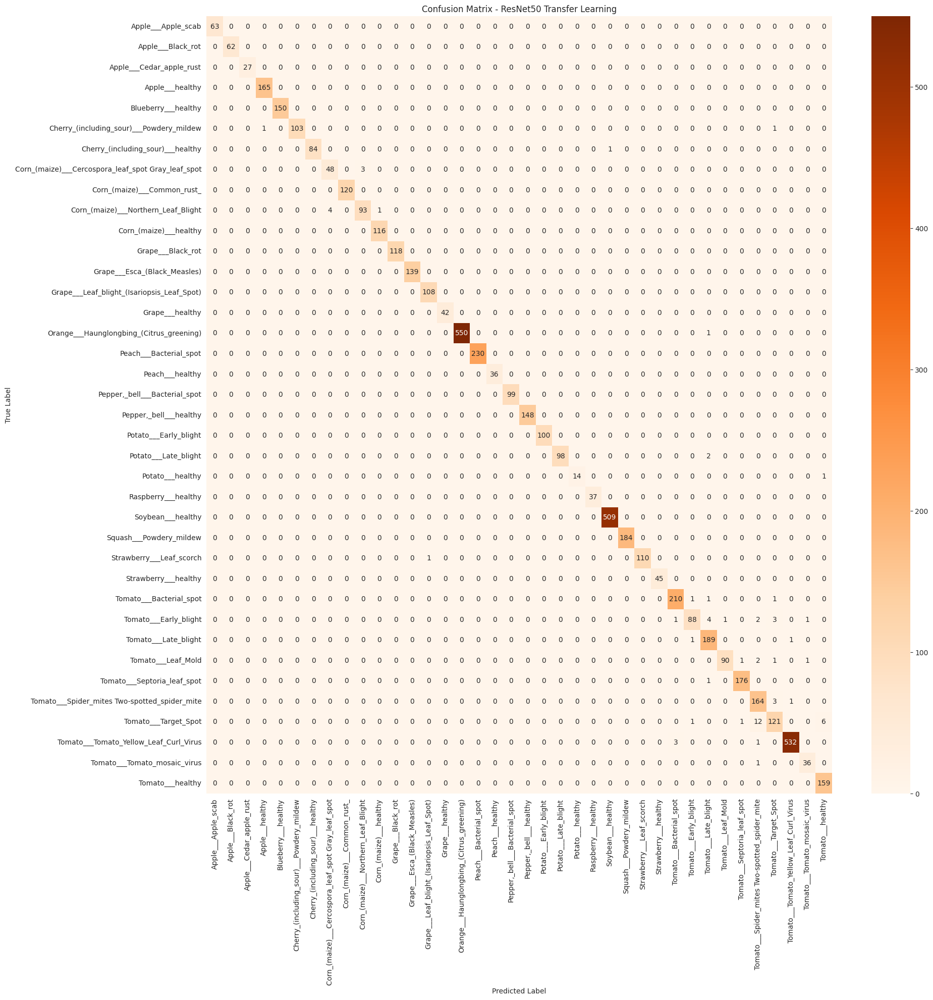


--- ResNet50 Classification Report ---
                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      1.00      1.00        63
                                 Apple___Black_rot       1.00      1.00      1.00        62
                          Apple___Cedar_apple_rust       1.00      1.00      1.00        27
                                   Apple___healthy       0.99      1.00      1.00       165
                               Blueberry___healthy       1.00      1.00      1.00       150
          Cherry_(including_sour)___Powdery_mildew       1.00      0.98      0.99       105
                 Cherry_(including_sour)___healthy       1.00      0.99      0.99        85
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.92      0.94      0.93        51
                       Corn_(maize)___Common_rust_       1.00      1.00      1.00       120
               Corn_(maize)___Northern_

In [ ]:
# 7.4 Evaluate ResNet50 on Test Data

from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import numpy as np

# --- 1. Prepare Test Generator for ResNet (Crucial!) ---
# We cannot use the old test_gen because ResNet needs specific preprocessing
test_datagen_resnet = ImageDataGenerator(
    preprocessing_function=preprocess_input # <--- Must match training preprocessing
)

print("--- Loading Test Data for ResNet50 ---")
test_gen_resnet = test_datagen_resnet.flow_from_dataframe(
    dataframe=test_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False,  # Important for Confusion Matrix
    seed=42
)

# --- 2. Load the Best Saved ResNet Model ---
print("\n--- Loading Best ResNet50 Checkpoint ---")
best_resnet_model = tf.keras.models.load_model("/kaggle/working/model_checkpoints/best_resnet50.keras")

# --- 3. Evaluate ---
print("\n--- Evaluating on Test Set ---")
test_loss, test_acc = best_resnet_model.evaluate(test_gen_resnet)
print(f"\nResNet50 Test Accuracy: {test_acc * 100:.2f}%")
print(f"ResNet50 Test Loss: {test_loss:.4f}")

# --- 4. Generate Predictions & Confusion Matrix ---
test_gen_resnet.reset()
predictions = best_resnet_model.predict(test_gen_resnet, verbose=1)
predicted_indices = np.argmax(predictions, axis=1)
true_indices = test_gen_resnet.classes
class_labels = list(test_gen_resnet.class_indices.keys())

# Plot Confusion Matrix
cm = confusion_matrix(true_indices, predicted_indices)
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Oranges', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix - ResNet50 Transfer Learning')
plt.show()

# --- 5. Classification Report ---
print("\n--- ResNet50 Classification Report ---")
print(classification_report(true_indices, predicted_indices, target_names=class_labels))

--- Loading ResNet50 Model ---


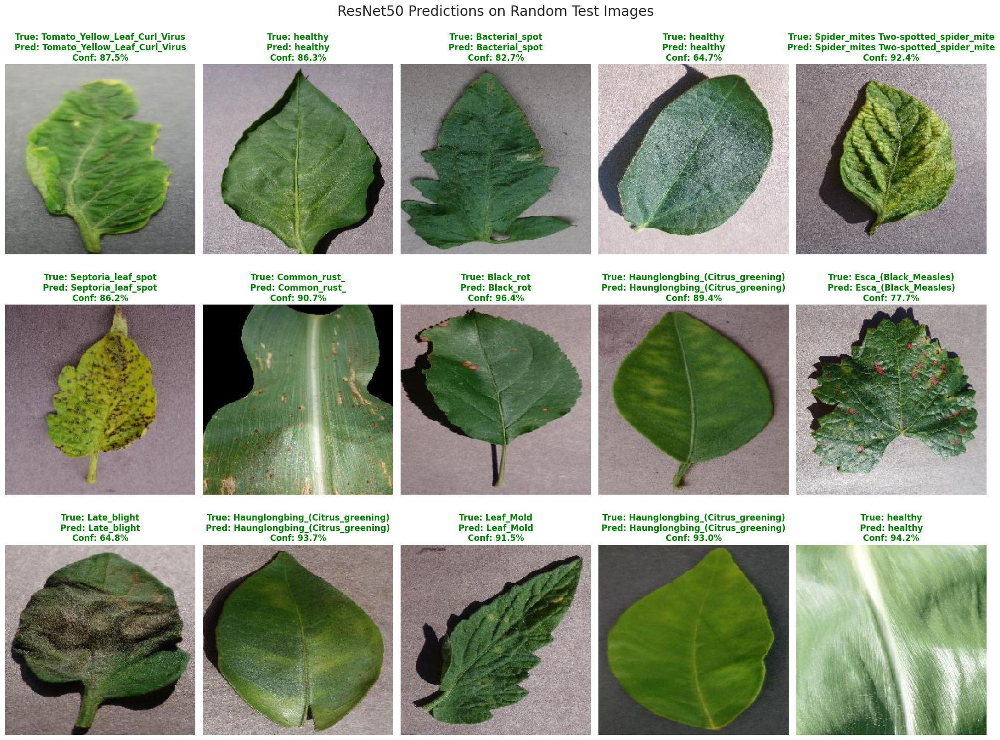

In [ ]:
# 9.2 Visualizing Random Sample Predictions using ResNet50

import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import preprocess_input # <--- Crucial Import

# 1. Load the Best ResNet50 Model
print("--- Loading ResNet50 Model ---")
model_resnet_pred = tf.keras.models.load_model("/kaggle/working/model_checkpoints/best_resnet50.keras")

# 2. Get Class Labels
class_map = {v: k for k, v in train_gen.class_indices.items()}

# 3. Select Random Images
num_samples = 15
random_indices = np.random.choice(len(test_data), num_samples, replace=False)

plt.figure(figsize=(20, 15))

for i, idx in enumerate(random_indices):
    # Get image path and true label
    row = test_data.iloc[idx]
    img_path = row['filepaths']
    true_label = row['labels']

    # --- Image Loading ---
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=IMG_SIZE)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # --- Preprocessing for ResNet (Difference is HERE) ---
    # We need two versions:
    # 1. 'display_img' for showing in matplotlib (needs to be standard RGB)
    # 2. 'pred_img' for the model (needs specific ResNet preprocessing)

    display_img = img_array.astype('uint8') # Keep original for display

    pred_img = img_array.copy() # Make a copy for preprocessing
    pred_img = np.expand_dims(pred_img, axis=0) # Shape: (1, 224, 224, 3)
    pred_img = preprocess_input(pred_img) # <--- Apply ResNet Magic

    # --- Prediction ---
    prediction = model_resnet_pred.predict(pred_img, verbose=0)
    pred_idx = np.argmax(prediction)
    pred_label = class_map[pred_idx]
    confidence = np.max(prediction) * 100

    # --- Plotting ---
    plt.subplot(3, 5, i + 1)
    plt.imshow(display_img) # Show the normal image

    # Logic: Green if correct, Red if wrong
    color = 'green' if true_label == pred_label else 'red'

    title_true = true_label.split('___')[-1]
    title_pred = pred_label.split('___')[-1]

    plt.title(f"True: {title_true}\nPred: {title_pred}\nConf: {confidence:.1f}%",
              color=color, fontsize=12, fontweight='bold')
    plt.axis('off')

plt.tight_layout()
plt.suptitle("ResNet50 Predictions on Random Test Images", fontsize=20, y=1.02)
plt.show()

# 8. Transfer Learning with MobileNetV2
Finally, we evaluate **MobileNetV2**, a lightweight architecture optimized for mobile and edge devices. It utilizes **Depthwise Separable Convolutions** to reduce the number of parameters and computation cost significantly.

We apply the same transfer learning strategy:
1.  **Preprocessing:** Inputs are scaled to `[-1, 1]` using MobileNetV2's specific preprocessing function.
2.  **Feature Extraction:** The pre-trained base is frozen to act as a robust feature extractor.
3.  **Head:** The same custom classification head is attached to ensure a fair comparison with ResNet50 and our Custom CNN.

In [ ]:
# 8.1 Preprocessing Setup for MobileNetV2 (Crucial!)

from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input

BATCH_SIZE = 32
IMG_SIZE = (224, 224)

# --- 1. Training Generator (MobileNet Specific) ---
# Note: MobileNetV2 expects pixels in [-1, 1], so we MUST use its preprocess_input
train_datagen_mobile = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# --- 2. Validation Generator (MobileNet Specific) ---
test_datagen_mobile = ImageDataGenerator(
    preprocessing_function=preprocess_input
)

# --- 3. Reload Data ---
print("--- Reloading Data for MobileNetV2 ---")

train_gen_mobile = train_datagen_mobile.flow_from_dataframe(
    dataframe=train_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42
)

valid_gen_mobile = test_datagen_mobile.flow_from_dataframe(
    dataframe=valid_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False,
    seed=42
)

--- Reloading Data for MobileNetV2 ---
Found 43444 validated image filenames belonging to 38 classes.
Found 5430 validated image filenames belonging to 38 classes.


In [ ]:
# 8.2 Building and Training MobileNetV2

# --- Configuration ---
IMG_SHAPE = (224, 224, 3)
NUM_CLASSES = len(train_gen.class_indices)
EPOCHS_TL = 20

# --- 1. Load Base Model ---
# include_top=False: Remove the ImageNet classifier
# weights='imagenet': Load pre-trained weights
base_model_mobile = MobileNetV2(weights='imagenet', include_top=False, input_shape=IMG_SHAPE)

# --- 2. Freeze Base Model ---
base_model_mobile.trainable = False

# --- 3. Add Custom Head (Same as ResNet/Custom CNN) ---
x = base_model_mobile.output
x = GlobalAveragePooling2D()(x)

x = Dense(256)(x)
x = BatchNormalization()(x)
x = Activation('swish')(x)
x = Dropout(0.5)(x)

predictions = Dense(NUM_CLASSES, activation='softmax')(x)

# --- 4. Final Model ---
mobile_model = Model(inputs=base_model_mobile.input, outputs=predictions)

# Check model size (Should be much smaller than ResNet)
mobile_model.summary()
print(f"MobileNetV2 Initialized. Total Layers: {len(mobile_model.layers)}")


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_62"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_2[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,596,710 (9.91 MB)

 Trainable params: 338,214 (1.29 MB)

 Non-trainable params: 2,258,496 (8.62 MB)

MobileNetV2 Initialized. Total Layers: 160


In [ ]:

# --- 5. Compile ---
print("\n--- Compiling MobileNetV2 ---")
mobile_model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss=CategoricalCrossentropy(label_smoothing=0.1),
    metrics=['accuracy']
)


--- Compiling MobileNetV2 ---


In [ ]:
# --- 6. Callbacks ---
checkpoint_filepath_mobile = os.path.join(checkpoint_dir, "best_mobilenetv2.keras")

callbacks_mobile = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True, verbose=1),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5, verbose=1),
    ModelCheckpoint(filepath=checkpoint_filepath_mobile, monitor='val_loss', save_best_only=True, verbose=1)
]

In [ ]:
# --- 7. Start Training ---
print("\n--- Starting MobileNetV2 Training ---")
history_mobile = mobile_model.fit(
    train_gen_mobile,
    epochs=EPOCHS_TL,
    validation_data=valid_gen_mobile,
    callbacks=callbacks_mobile,
    verbose=1
)


--- Starting MobileNetV2 Training ---
Epoch 1/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step - accuracy: 0.7655 - loss: 1.4721
Epoch 1: val_loss improved from inf to 0.97202, saving model to /kaggle/working/model_checkpoints/best_mobilenetv2.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 597s 429ms/step - accuracy: 0.7656 - loss: 1.4719 - val_accuracy: 0.9322 - val_loss: 0.9720 - learning_rate: 0.0010
Epoch 2/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - accuracy: 0.9076 - loss: 1.0583
Epoch 2: val_loss improved from 0.97202 to 0.94098, saving model to /kaggle/working/model_checkpoints/best_mobilenetv2.keras
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 576s 424ms/step - accuracy: 0.9076 - loss: 1.0583 - val_accuracy: 0.9396 - val_loss: 0.9410 - learning_rate: 0.0010
Epoch 3/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - accuracy: 0.9182 - loss: 1.0200
Epoch 3: val_loss improved from 0.94098 to 0.93061, saving model to /kaggle/working/model_checkpoints/best_mobilenetv2.keras
1358/1358 ━━━━━━━━━━━━━━━━

#### **Visualizing Training History (Graphs)**

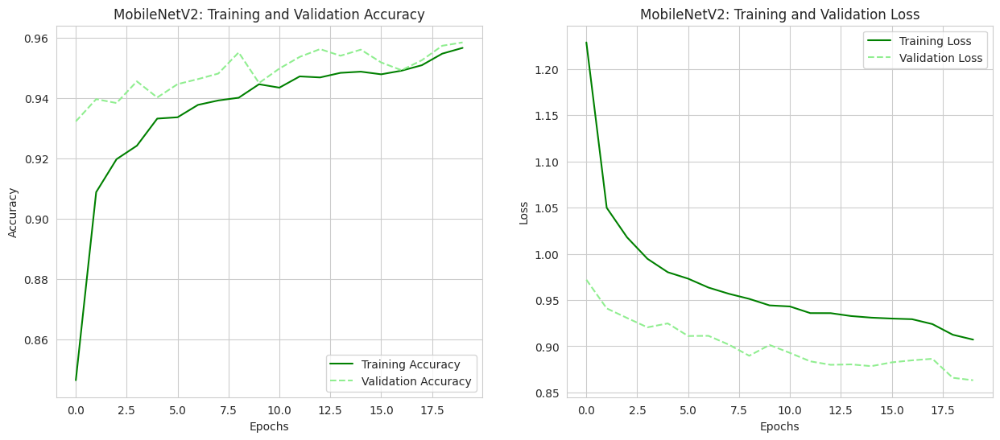

In [ ]:
# 8.3 Visualize MobileNetV2 Training History

import matplotlib.pyplot as plt

def plot_training_history_mobile(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs_range = range(len(acc))

    plt.figure(figsize=(15, 6))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy', color='green')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy', color='lightgreen', linestyle='--')
    plt.legend(loc='lower right')
    plt.title('MobileNetV2: Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss', color='green')
    plt.plot(epochs_range, val_loss, label='Validation Loss', color='lightgreen', linestyle='--')
    plt.legend(loc='upper right')
    plt.title('MobileNetV2: Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')

    plt.show()

# Plot the graphs for MobileNetV2
plot_training_history_mobile(history_mobile)

#### **8.4 Evaluation of MobileNetV2 on Test Data**
We assess the performance of the lightweight **MobileNetV2** model on the test set. The test images are preprocessed using the specific mapping required by MobileNetV2 to ensuring valid comparisons.

--- Loading Test Data for MobileNetV2 ---
Found 5431 validated image filenames belonging to 38 classes.

--- Loading Best MobileNetV2 Checkpoint ---

--- Evaluating on Test Set ---
170/170 ━━━━━━━━━━━━━━━━━━━━ 24s 101ms/step - accuracy: 0.9597 - loss: 0.8690

MobileNetV2 Test Accuracy: 96.19%
MobileNetV2 Test Loss: 0.8603
170/170 ━━━━━━━━━━━━━━━━━━━━ 21s 92ms/step


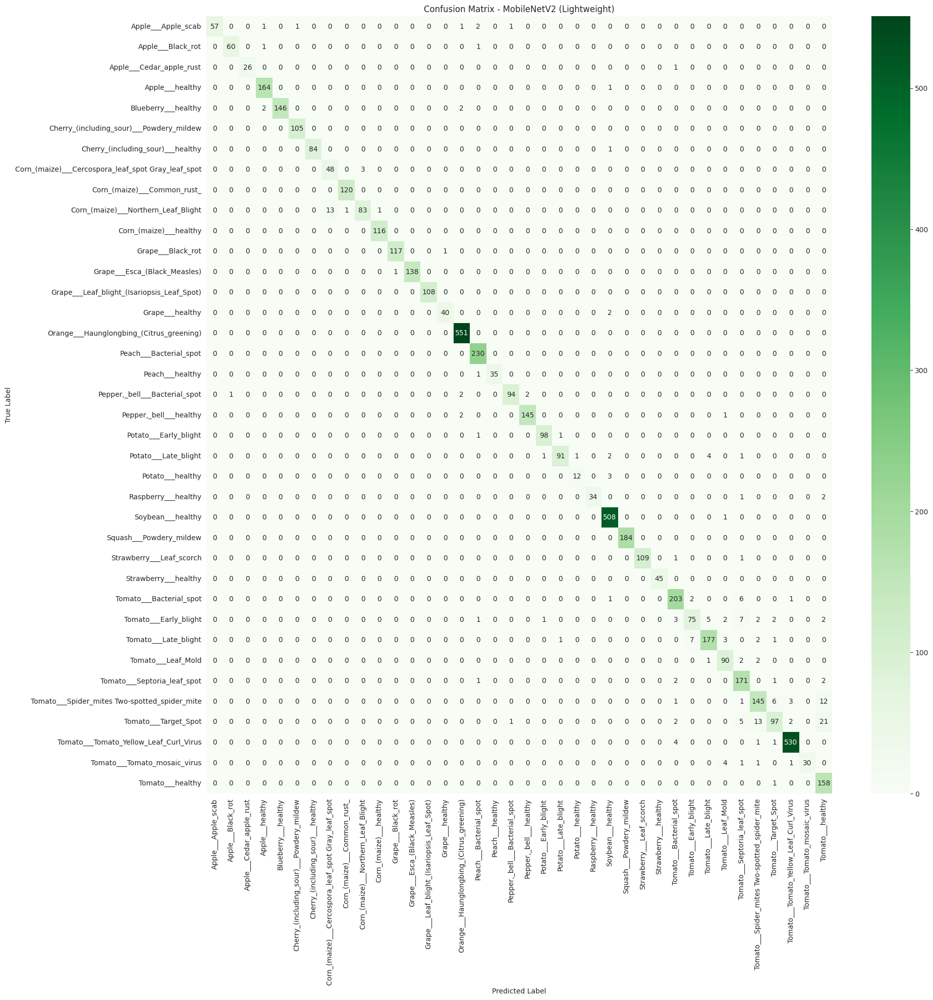


--- MobileNetV2 Classification Report ---
                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      0.90      0.95        63
                                 Apple___Black_rot       0.98      0.97      0.98        62
                          Apple___Cedar_apple_rust       1.00      0.96      0.98        27
                                   Apple___healthy       0.98      0.99      0.98       165
                               Blueberry___healthy       1.00      0.97      0.99       150
          Cherry_(including_sour)___Powdery_mildew       0.99      1.00      1.00       105
                 Cherry_(including_sour)___healthy       1.00      0.99      0.99        85
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.79      0.94      0.86        51
                       Corn_(maize)___Common_rust_       0.99      1.00      1.00       120
               Corn_(maize)___Northe

In [ ]:
# 8.4 Evaluate MobileNetV2 on Test Data

from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import numpy as np

# --- 1. Prepare Test Generator for MobileNetV2 (Crucial!) ---
test_datagen_mobile = ImageDataGenerator(
    preprocessing_function=preprocess_input # <--- Must match MobileNetV2 training preprocessing
)

print("--- Loading Test Data for MobileNetV2 ---")
test_gen_mobile = test_datagen_mobile.flow_from_dataframe(
    dataframe=test_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False,  # Important for Confusion Matrix
    seed=42
)

# --- 2. Load the Best Saved MobileNetV2 Model ---
print("\n--- Loading Best MobileNetV2 Checkpoint ---")
# Ensure the filename matches what was saved in Step 8.2
best_mobile_model = tf.keras.models.load_model("/kaggle/working/model_checkpoints/best_mobilenetv2.keras")

# --- 3. Evaluate ---
print("\n--- Evaluating on Test Set ---")
test_loss, test_acc = best_mobile_model.evaluate(test_gen_mobile)
print(f"\nMobileNetV2 Test Accuracy: {test_acc * 100:.2f}%")
print(f"MobileNetV2 Test Loss: {test_loss:.4f}")

# --- 4. Generate Predictions & Confusion Matrix ---
test_gen_mobile.reset()
predictions = best_mobile_model.predict(test_gen_mobile, verbose=1)
predicted_indices = np.argmax(predictions, axis=1)
true_indices = test_gen_mobile.classes
class_labels = list(test_gen_mobile.class_indices.keys())

# Plot Confusion Matrix (Using Green Theme)
cm = confusion_matrix(true_indices, predicted_indices)
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Greens', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix - MobileNetV2 (Lightweight)')
plt.show()

# --- 5. Classification Report ---
print("\n--- MobileNetV2 Classification Report ---")
print(classification_report(true_indices, predicted_indices, target_names=class_labels))

--- Loading MobileNetV2 Model ---


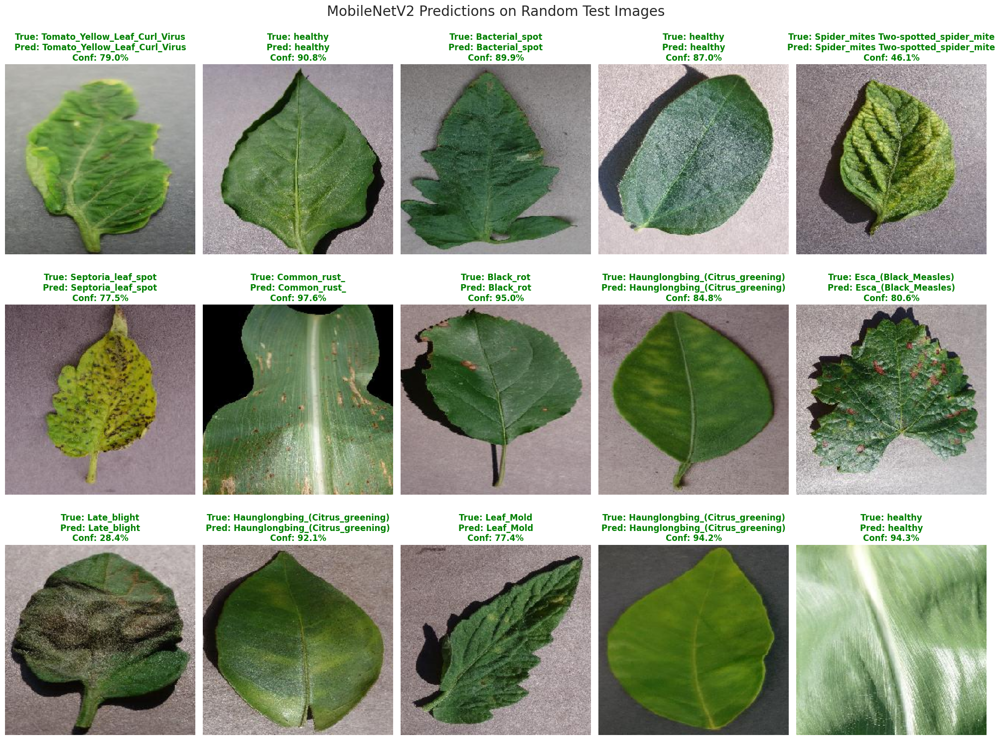

In [ ]:
# 9.3 Visualizing Random Sample Predictions using MobileNetV2

import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input # <--- Crucial Import for MobileNet

# 1. Load the Best MobileNetV2 Model
print("--- Loading MobileNetV2 Model ---")
model_mobile_pred = tf.keras.models.load_model("/kaggle/working/model_checkpoints/best_mobilenetv2.keras")

# 2. Get Class Labels
class_map = {v: k for k, v in train_gen.class_indices.items()}

# 3. Select Random Images
num_samples = 15
random_indices = np.random.choice(len(test_data), num_samples, replace=False)

plt.figure(figsize=(20, 15))

for i, idx in enumerate(random_indices):
    # Get image path and true label
    row = test_data.iloc[idx]
    img_path = row['filepaths']
    true_label = row['labels']

    # --- Image Loading ---
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=IMG_SIZE)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # --- Preprocessing for MobileNetV2 ---
    display_img = img_array.astype('uint8') # Original for display

    pred_img = img_array.copy()
    pred_img = np.expand_dims(pred_img, axis=0)
    pred_img = preprocess_input(pred_img) # <--- Scales to [-1, 1]

    # --- Prediction ---
    prediction = model_mobile_pred.predict(pred_img, verbose=0)
    pred_idx = np.argmax(prediction)
    pred_label = class_map[pred_idx]
    confidence = np.max(prediction) * 100

    # --- Plotting ---
    plt.subplot(3, 5, i + 1)
    plt.imshow(display_img)

    # Green if correct, Red if wrong
    color = 'green' if true_label == pred_label else 'red'

    title_true = true_label.split('___')[-1]
    title_pred = pred_label.split('___')[-1]

    plt.title(f"True: {title_true}\nPred: {title_pred}\nConf: {confidence:.1f}%",
              color=color, fontsize=12, fontweight='bold')
    plt.axis('off')

plt.tight_layout()
plt.suptitle("MobileNetV2 Predictions on Random Test Images", fontsize=20, y=1.02)
plt.show()

# 9. Comparative Analysis of Models
In this section, we compare the performance of our three implemented models:
1.  **Proposed Custom CNN:** A lightweight model designed from scratch.
2.  **ResNet50:** A heavy, high-performance transfer learning model.
3.  **MobileNetV2:** A lightweight transfer learning model optimized for mobile devices.

We evaluate them based on **Test Accuracy** and **Test Loss**.

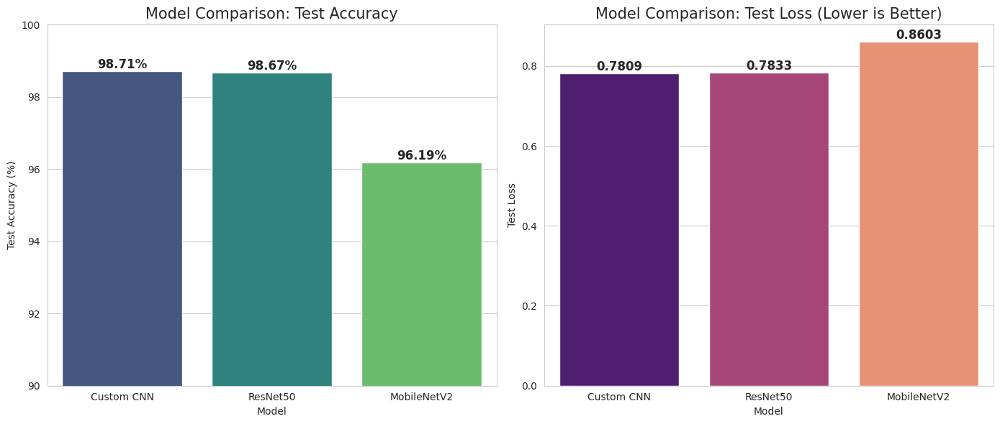


--- Final Performance Summary ---
         Model  Test Accuracy (%)  Test Loss
0   Custom CNN              98.71     0.7809
1     ResNet50              98.67     0.7833
2  MobileNetV2              96.19     0.8603


In [ ]:
# 9. Model Comparison Visualization

import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# --- Data Preparation ---
# Replace these values with your exact recorded results
results = {
    'Model': ['Custom CNN', 'ResNet50', 'MobileNetV2'],
    'Test Accuracy (%)': [98.71, 98.67, 96.19],
    'Test Loss': [0.7809, 0.7833, 0.8603]
}

df_results = pd.DataFrame(results)

# --- Plotting ---
plt.figure(figsize=(14, 6))

# Subplot 1: Accuracy Comparison
plt.subplot(1, 2, 1)
ax1 = sns.barplot(x='Model', y='Test Accuracy (%)', data=df_results, palette='viridis')
plt.title('Model Comparison: Test Accuracy', fontsize=15)
plt.ylim(90, 100) # Zoom in to show differences clearly
for p in ax1.patches:
    ax1.annotate(f'{p.get_height():.2f}%',
                 (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha='center', va='bottom', fontsize=12, fontweight='bold')

# Subplot 2: Loss Comparison
plt.subplot(1, 2, 2)
ax2 = sns.barplot(x='Model', y='Test Loss', data=df_results, palette='magma')
plt.title('Model Comparison: Test Loss (Lower is Better)', fontsize=15)
for p in ax2.patches:
    ax2.annotate(f'{p.get_height():.4f}',
                 (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha='center', va='bottom', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

# Display the Table
print("\n--- Final Performance Summary ---")
print(df_results)


--- Preparing Ground Truth Labels ---
Found 5431 validated image filenames belonging to 38 classes.

Processing: best_custom_cnn.keras...
Found 5431 validated image filenames belonging to 38 classes.
170/170 ━━━━━━━━━━━━━━━━━━━━ 13s 68ms/step

Processing: best_resnet50.keras...
Found 5431 validated image filenames belonging to 38 classes.
170/170 ━━━━━━━━━━━━━━━━━━━━ 23s 108ms/step

Processing: best_mobilenetv2.keras...
Found 5431 validated image filenames belonging to 38 classes.
170/170 ━━━━━━━━━━━━━━━━━━━━ 20s 92ms/step

--- Plotting AUC-ROC Curve ---


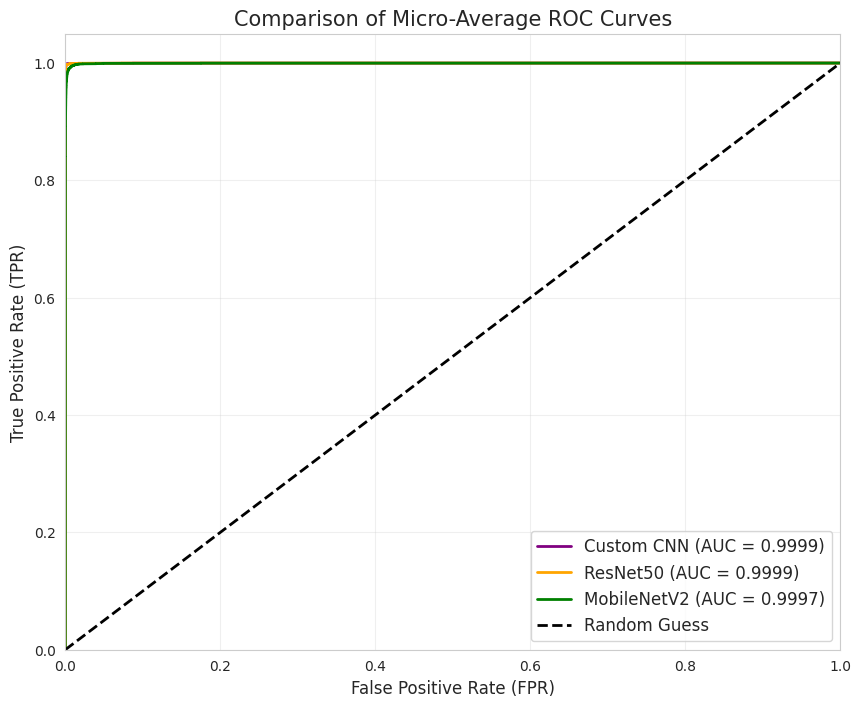

In [ ]:
# 9.2 Comparison of AUC-ROC Curves for All Models

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_resnet
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_mobile
import tensorflow as tf
import gc  # Garbage collector to save RAM

# --- Configuration ---
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
num_classes = 38

# Prepare True Labels (One-Hot Encoded)
# We need to load labels just once to set up the ground truth
print("--- Preparing Ground Truth Labels ---")
temp_gen = ImageDataGenerator(rescale=1./255).flow_from_dataframe(
    dataframe=test_data,
    x_col='filepaths',
    y_col='labels',
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    shuffle=False, # Crucial: Keep order intact
    class_mode='categorical'
)
y_true = temp_gen.classes
y_true_bin = label_binarize(y_true, classes=range(num_classes))

# --- Helper Function to Get Predictions ---
def get_model_predictions(model_path, preprocess_func):
    print(f"\nProcessing: {model_path.split('/')[-1]}...")

    # Setup Generator
    test_datagen = ImageDataGenerator(preprocessing_function=preprocess_func)
    test_gen = test_datagen.flow_from_dataframe(
        dataframe=test_data,
        x_col='filepaths',
        y_col='labels',
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        shuffle=False,
        class_mode='categorical'
    )

    # Load Model
    model = load_model(model_path)

    # Predict
    y_pred_proba = model.predict(test_gen, verbose=1)

    # Cleanup to save RAM
    del model
    tf.keras.backend.clear_session()
    gc.collect()

    return y_pred_proba

# --- 1. Get Predictions for Custom CNN ---
# Custom CNN uses 1/255 rescaling, so we define a simple lambda function
custom_cnn_preds = get_model_predictions(
    "/kaggle/working/model_checkpoints/best_custom_cnn.keras",
    lambda x: x / 255.0
)

# --- 2. Get Predictions for ResNet50 ---
resnet_preds = get_model_predictions(
    "/kaggle/working/model_checkpoints/best_resnet50.keras",
    preprocess_resnet
)

# --- 3. Get Predictions for MobileNetV2 ---
mobile_preds = get_model_predictions(
    "/kaggle/working/model_checkpoints/best_mobilenetv2.keras",
    preprocess_mobile
)

# --- 4. Calculate ROC & Plot ---
print("\n--- Plotting AUC-ROC Curve ---")

plt.figure(figsize=(10, 8))

models_data = [
    ("Custom CNN", custom_cnn_preds, "purple"),
    ("ResNet50", resnet_preds, "orange"),
    ("MobileNetV2", mobile_preds, "green")
]

for name, preds, color in models_data:
    # Compute Micro-Average ROC curve and ROC area
    fpr, tpr, _ = roc_curve(y_true_bin.ravel(), preds.ravel())
    roc_auc = auc(fpr, tpr)

    plt.plot(fpr, tpr,
             label=f'{name} (AUC = {roc_auc:.4f})',
             color=color, linewidth=2)

# Plot Random Guess Line
plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Guess')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (FPR)', fontsize=12)
plt.ylabel('True Positive Rate (TPR)', fontsize=12)
plt.title('Comparison of Micro-Average ROC Curves', fontsize=15)
plt.legend(loc="lower right", fontsize=12)
plt.grid(alpha=0.3)
plt.show()

--- Evaluating Custom CNN ---
Found 5431 validated image filenames belonging to 38 classes.
170/170 ━━━━━━━━━━━━━━━━━━━━ 13s 69ms/step
--- Evaluating ResNet50 ---
Found 5431 validated image filenames belonging to 38 classes.
170/170 ━━━━━━━━━━━━━━━━━━━━ 23s 112ms/step
--- Evaluating MobileNetV2 ---
Found 5431 validated image filenames belonging to 38 classes.
170/170 ━━━━━━━━━━━━━━━━━━━━ 20s 91ms/step


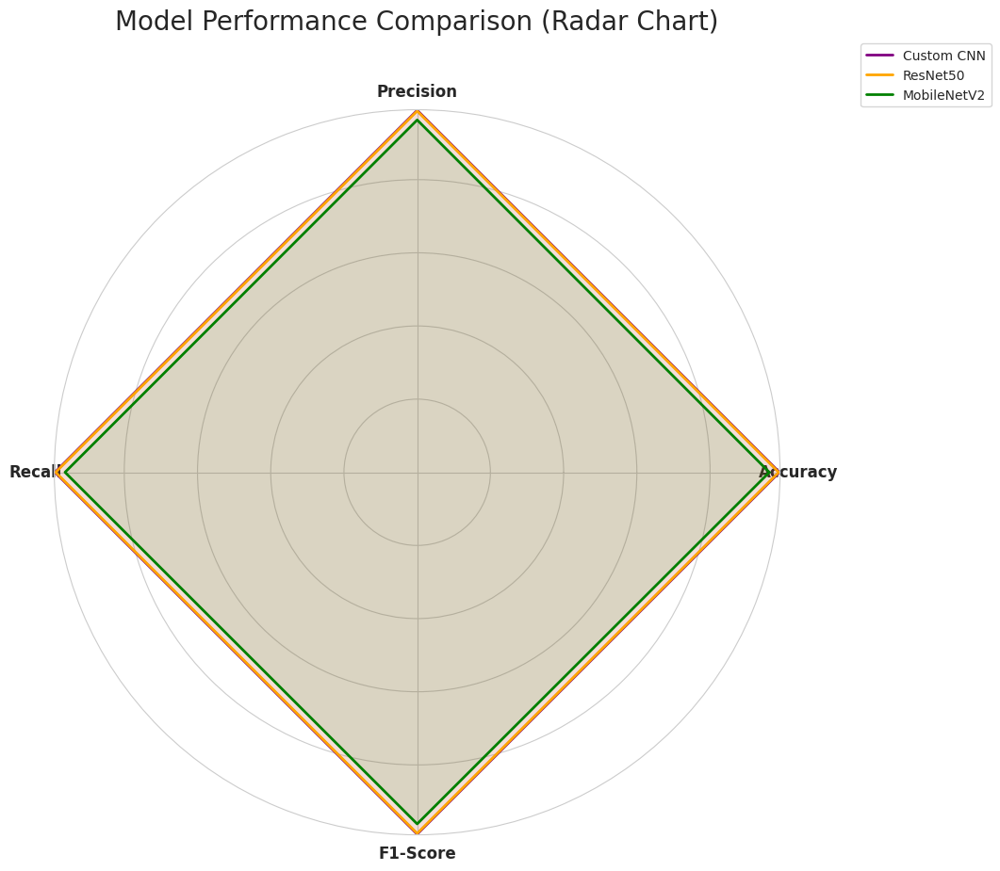


--- Efficiency Statistics ---
             Accuracy  Size (MB)  Time (ms/img)
Custom CNN   0.989321   7.570018       2.402822
ResNet50     0.987479  96.739465       4.350140
MobileNetV2  0.961885  13.056147       3.787229


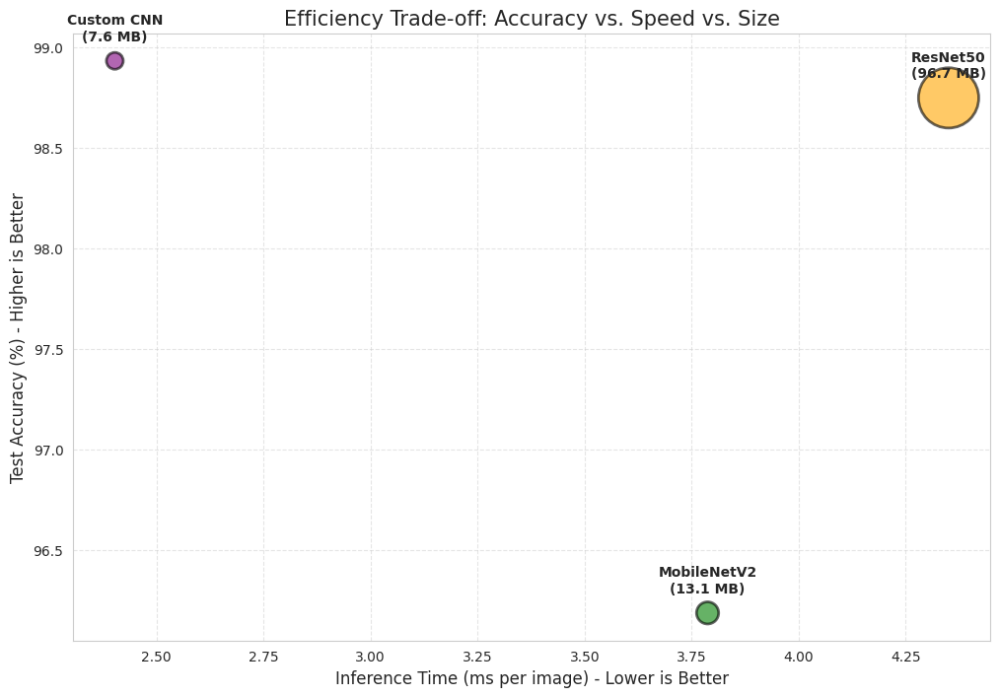

In [ ]:
# 9.3 Advanced Comparison: Radar Chart & Efficiency Analysis

import numpy as np
import matplotlib.pyplot as plt
import os
import time
from sklearn.metrics import precision_recall_fscore_support, accuracy_score
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_resnet
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_mobile
import tensorflow as tf
import gc

# --- Configuration ---
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
model_paths = {
    'Custom CNN': "/kaggle/working/model_checkpoints/best_custom_cnn.keras",
    'ResNet50': "/kaggle/working/model_checkpoints/best_resnet50.keras",
    'MobileNetV2': "/kaggle/working/model_checkpoints/best_mobilenetv2.keras"
}

# --- Function to Evaluate Metrics & Speed ---
def evaluate_model_performance(name, model_path, preprocess_func):
    print(f"--- Evaluating {name} ---")

    # 1. Measure Model Size
    file_size = os.path.getsize(model_path) / (1024 * 1024) # Convert to MB

    # 2. Prepare Data
    test_datagen = ImageDataGenerator(preprocessing_function=preprocess_func)
    test_gen = test_datagen.flow_from_dataframe(
        dataframe=test_data,
        x_col='filepaths',
        y_col='labels',
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        shuffle=False,
        class_mode='categorical'
    )

    # 3. Load Model
    model = load_model(model_path)

    # 4. Measure Inference Time (Speed)
    start_time = time.time()
    y_pred_probs = model.predict(test_gen, verbose=1)
    end_time = time.time()

    inference_time = (end_time - start_time) / len(test_data) * 1000 # ms per image

    # 5. Calculate Metrics
    y_pred = np.argmax(y_pred_probs, axis=1)
    y_true = test_gen.classes

    acc = accuracy_score(y_true, y_pred)
    prec, rec, f1, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted')

    # Cleanup
    del model
    tf.keras.backend.clear_session()
    gc.collect()

    return {
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F1-Score': f1,
        'Size (MB)': file_size,
        'Time (ms/img)': inference_time
    }

# --- Run Evaluation ---
# Custom CNN (1/255 scaling)
stats_cnn = evaluate_model_performance('Custom CNN', model_paths['Custom CNN'], lambda x: x / 255.0)

# ResNet50
stats_resnet = evaluate_model_performance('ResNet50', model_paths['ResNet50'], preprocess_resnet)

# MobileNetV2
stats_mobile = evaluate_model_performance('MobileNetV2', model_paths['MobileNetV2'], preprocess_mobile)

# Combine Data
all_stats = {'Custom CNN': stats_cnn, 'ResNet50': stats_resnet, 'MobileNetV2': stats_mobile}

# --- Visualization 1: Radar Chart ---
labels = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
num_vars = len(labels)

# Compute angle for each axis
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1] # Close the loop

plt.figure(figsize=(10, 10))
ax = plt.subplot(111, polar=True)

# Plot each model
colors = ['purple', 'orange', 'green']
for (name, stats), color in zip(all_stats.items(), colors):
    values = [stats[label] for label in labels]
    values += values[:1] # Close the loop

    ax.plot(angles, values, color=color, linewidth=2, label=name)
    ax.fill(angles, values, color=color, alpha=0.1)

ax.set_yticklabels([])
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels, fontsize=12, fontweight='bold')
plt.title('Model Performance Comparison (Radar Chart)', size=20, y=1.1)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()

# --- Visualization 2: Efficiency Comparison (Bubble Chart) ---
# X-axis: Inference Time, Y-axis: Accuracy, Bubble Size: Model Size

plt.figure(figsize=(12, 8))

times = [stats['Time (ms/img)'] for stats in all_stats.values()]
accs = [stats['Accuracy'] * 100 for stats in all_stats.values()]
sizes = [stats['Size (MB)'] for stats in all_stats.values()]
names = list(all_stats.keys())
colors = ['purple', 'orange', 'green']

# Scatter plot
scatter = plt.scatter(times, accs, s=[s * 20 for s in sizes], c=colors, alpha=0.6, edgecolors="black", linewidth=2)

# Annotate
for i, name in enumerate(names):
    plt.annotate(
        f"{name}\n({sizes[i]:.1f} MB)",
        (times[i], accs[i]),
        xytext=(0, 15), textcoords='offset points', ha='center', fontweight='bold'
    )

plt.xlabel('Inference Time (ms per image) - Lower is Better', fontsize=12)
plt.ylabel('Test Accuracy (%) - Higher is Better', fontsize=12)
plt.title('Efficiency Trade-off: Accuracy vs. Speed vs. Size', fontsize=15)
plt.grid(True, linestyle='--', alpha=0.5)

# Create a custom legend for bubble sizes is tricky, so we rely on labels
print("\n--- Efficiency Statistics ---")
import pandas as pd
df_stats = pd.DataFrame(all_stats).T
print(df_stats[['Accuracy', 'Size (MB)', 'Time (ms/img)']])

plt.show()

# 10. Explainable AI (XAI): Grad-CAM Visualization
To ensure transparency and interpretability of our "black-box" deep learning model, we implement **Grad-CAM (Gradient-weighted Class Activation Mapping)**. This technique highlights the regions of the input image that were most influential in the model's classification decision, proving that the model is indeed focusing on disease symptoms (lesions, spots) rather than background noise.

--- Building Functional Model ---
Loading learned weights...
✅ Weights loaded successfully!
Targeting Layer: conv2d_5


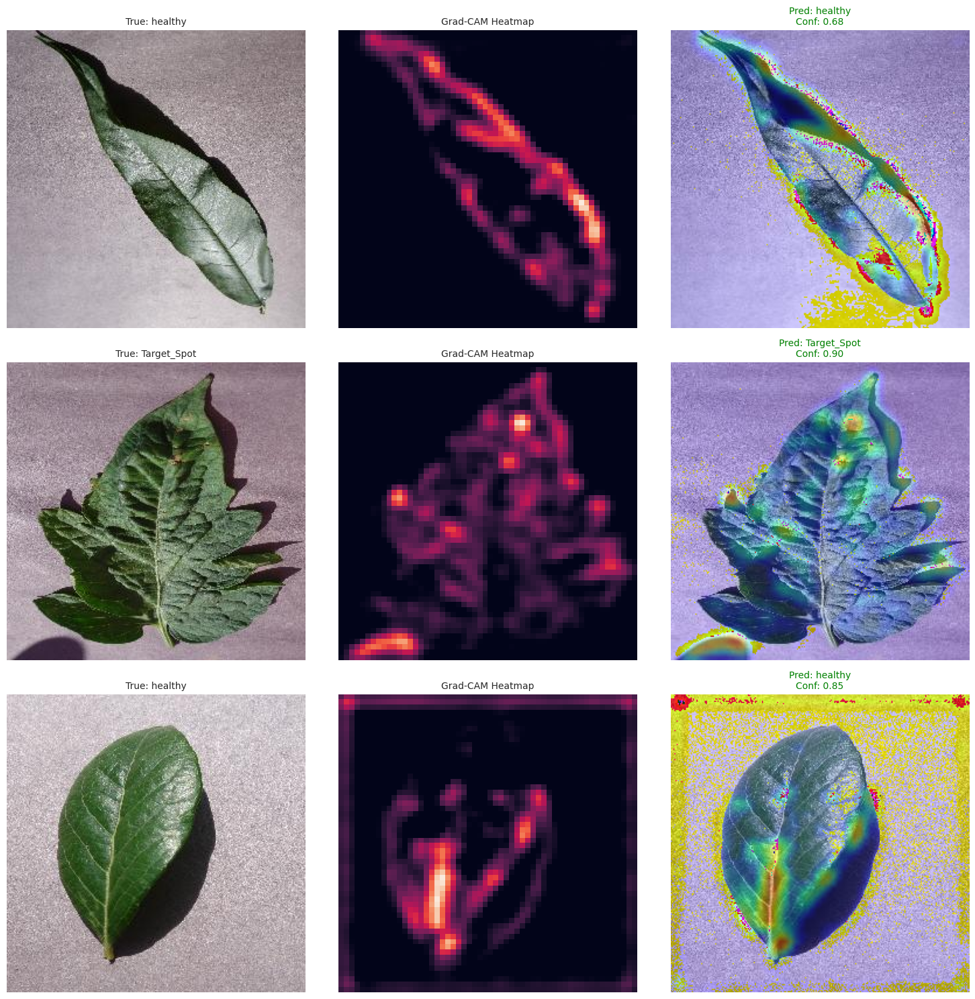

In [ ]:
import tensorflow as tf
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.layers import (
    Conv2D, BatchNormalization, MaxPooling2D, Dropout,
    Dense, GlobalAveragePooling2D, Activation, Input
)
from tensorflow.keras.models import Model

# --- 1. Re-Define Architecture using Functional API (Guaranteed Fix) ---
# Functional API creates the graph explicitly, preventing the "layer not called" error.

def build_functional_model(input_shape, num_classes):
    inputs = Input(shape=input_shape)

    # --- Block 1 ---
    x = Conv2D(32, (3, 3), padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)

    x = Conv2D(64, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.25)(x)

    # --- Block 2 ---
    x = Conv2D(64, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)

    x = Conv2D(128, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.25)(x)

    # --- Block 3 ---
    x = Conv2D(128, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)

    x = Conv2D(256, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)

    # --- Head ---
    x = GlobalAveragePooling2D()(x)

    x = Dense(256)(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    x = Dropout(0.5)(x)

    outputs = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# --- 2. Build Model & Load Weights ---
print("--- Building Functional Model ---")
NUM_CLASSES = len(train_gen.class_indices)
IMG_SHAPE = (224, 224, 3)

# Build the model
model_xai = build_functional_model(IMG_SHAPE, NUM_CLASSES)

# Load the saved weights (This works because the architecture is identical)
print("Loading learned weights...")
try:
    model_xai.load_weights("/kaggle/working/model_checkpoints/best_custom_cnn.keras")
    print("✅ Weights loaded successfully!")
except Exception as e:
    print(f"❌ Error loading weights: {e}")

# --- 3. Grad-CAM Functions ---

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # Now model.inputs and model.output are guaranteed to exist
    grad_model = tf.keras.models.Model(
        inputs=model.inputs,
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def display_gradcam(img_path, heatmap, alpha=0.4):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    heatmap = np.uint8(255 * heatmap)
    jet = plt.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = cv2.resize(jet_heatmap, (img.shape[1], img.shape[0]))
    jet_heatmap = np.uint8(255 * jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = np.uint8(superimposed_img)
    return superimposed_img

def find_last_conv_layer(model):
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            return layer.name
    raise ValueError("No Conv2D layer found.")

# --- 4. Generate Visualization ---
last_conv_layer_name = find_last_conv_layer(model_xai)
print(f"Targeting Layer: {last_conv_layer_name}")

num_images = 3
plt.figure(figsize=(15, 5 * num_images))

random_indices = np.random.choice(len(test_data), num_images, replace=False)

for i, idx in enumerate(random_indices):
    img_path = test_data.iloc[idx]['filepaths']
    true_label = test_data.iloc[idx]['labels']

    # Preprocess
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0  # Normalize

    # Predict
    preds = model_xai.predict(img_array, verbose=0)
    pred_index = np.argmax(preds[0])
    predicted_label = list(train_gen.class_indices.keys())[pred_index]
    confidence = np.max(preds[0])

    # Generate Heatmap
    heatmap = make_gradcam_heatmap(img_array, model_xai, last_conv_layer_name)
    superimposed_img = display_gradcam(img_path, heatmap)

    # Plotting
    plt.subplot(num_images, 3, i*3 + 1)
    plt.imshow(plt.imread(img_path))
    plt.title(f"True: {true_label.split('___')[-1]}", fontsize=10)
    plt.axis('off')

    plt.subplot(num_images, 3, i*3 + 2)
    plt.imshow(heatmap)
    plt.title("Grad-CAM Heatmap", fontsize=10)
    plt.axis('off')

    plt.subplot(num_images, 3, i*3 + 3)
    plt.imshow(superimposed_img)
    plt.title(f"Pred: {predicted_label.split('___')[-1]}\nConf: {confidence:.2f}",
              fontsize=10, color='green' if true_label==predicted_label else 'red')
    plt.axis('off')

plt.tight_layout()
plt.show()